# Milestone 1

## 1- Implementing Data Biasness Rule from Responsible AI:

Checking biasness in data using machine learning models for responsible AI.
To check for bias in your data using machine learning models, we'll follow these steps:

- Preprocess the Data: Convert categorical variables or columns like 'geoAreaName', 'Nature' etc into numerical ones so that machine learning models can process them. 
- Train Models: Use models like Decision Trees and Gradient Boosting to train on the data.
- Analyze Feature Importance: Check which features are most influential in the model's predictions to understand potential biases. i.e which features are most important for models in predictions. 
- Visualize Results: Plot feature importances to visualize which features have the most impact.

In [1]:
# import all neccessary libaries 

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer
import numpy as np 

import os
import json5



#### Data Loading

In [2]:

# Load data into array
data_dir = './data/reduced_mixed_3/reduced_mixed_3/'
all_files = os.listdir(data_dir)
print(f"All files: {all_files}")


# Verify the content and structure of the files
data_entries = []
file_count = 0

for file_name in all_files:
    if file_name.startswith('sdgIndicatorData__') and file_name.endswith('.json5'):
        file_path = os.path.join(data_dir, file_name)
        file_count += 1
        with open(file_path, 'r') as f:
            try:
                data = json5.load(f)
                print(f"Loaded data from {file_name}: {data.keys()}")  # Print the keys to verify structure
                if 'data' in data:
                    data_entries.extend(data['data'])
            except Exception as e:
                print(f"Error loading {file_path}: {e}")

print(f"Total files processed: {file_count}")
print(f"Total data entries loaded: {len(data_entries)}")
if len(data_entries) > 0:
    print(json5.dumps(data_entries[0], indent=2))
else:
    print("No data entries loaded.")

All files: ['.ipynb_checkpoints', 'indicatorDataMeta.json5', 'indicatorPivotDataMeta.json5', 'sdgIndicatorData__1.1.1.json5', 'sdgIndicatorData__1.2.1.json5', 'sdgIndicatorData__1.2.2.json5', 'sdgIndicatorData__1.3.1.json5', 'sdgIndicatorData__1.4.1.json5', 'sdgIndicatorData__1.4.2.json5', 'sdgIndicatorData__1.5.1.json5', 'sdgIndicatorData__1.5.2.json5', 'sdgIndicatorData__1.5.3.json5', 'sdgIndicatorData__1.5.4.json5', 'sdgIndicatorData__1.a.1.json5', 'sdgIndicatorData__1.a.2.json5', 'sdgIndicatorData__1.b.1.json5', 'sdgIndicatorData__10.1.1.json5', 'sdgIndicatorData__10.2.1.json5', 'sdgIndicatorData__10.3.1.json5', 'sdgIndicatorData__10.4.1.json5', 'sdgIndicatorData__10.4.2.json5', 'sdgIndicatorData__10.5.1.json5', 'sdgIndicatorData__10.6.1.json5', 'sdgIndicatorData__10.7.1.json5', 'sdgIndicatorData__10.7.2.json5', 'sdgIndicatorData__10.7.3.json5', 'sdgIndicatorData__10.7.4.json5', 'sdgIndicatorData__10.a.1.json5', 'sdgIndicatorData__10.b.1.json5', 'sdgIndicatorData__10.c.1.json5', 's

#### Data Preprocessing:
First, we need to preprocess the data to convert it into a format that machine learning models can understand.

In [3]:

# Convert data to DataFrame
df = pd.DataFrame(data_entries)

# Flatten nested columns
df['goal'] = df['goal'].apply(lambda x: x[0])
df['target'] = df['target'].apply(lambda x: x[0])
df['indicator'] = df['indicator'].apply(lambda x: x[0])
df['key'] = df['key'].apply(lambda x: x[0])
df['footnotes'] = df['footnotes'].apply(lambda x: x[0] if x else None)



# Extract the 'Sex' value from 'dimensions'
df['Sex'] = df['dimensions'].apply(lambda x: x.get('Sex') if isinstance(x, dict) else None)

# Extract the 'Age' value from 'dimensions'
df['Age'] = df['dimensions'].apply(lambda x: x.get('Age') if isinstance(x, dict) else None)

# Extract the 'Reporting Type' value from 'dimensions'
df['Reporting Type']=  df['dimensions'].apply(lambda x: x.get('Reporting Type') if isinstance(x, dict) else None)

# Extract the 'Location' value from 'dimensions'
df['Location']=  df['dimensions'].apply(lambda x: x.get('Location') if isinstance(x, dict) else None)

# Extract the 'Nature' value from 'attributes'
df['Nature']=  df['attributes'].apply(lambda x: x.get('nature') if isinstance(x, dict) else None)

# Extract the 'Units' value from 'attributes'
df['Units']=  df['attributes'].apply(lambda x: x.get('Units') if isinstance(x, dict) else None)

# Extract the 'Observations' value from 'attributes'
df['Observation']=  df['attributes'].apply(lambda x: x.get('Observations') if isinstance(x, dict) else None)



# Select relevant columns for model
features = ['goal','seriesCount', 'geoAreaCode', 'geoAreaName','timePeriodStart','Sex', 'Age','Reporting Type','Location','Nature', 'Units','Observation']
df_features = df[features].copy()

# Handle missing values (if any)
df_features.fillna(value={'time_detail': '', 'timeCoverage': '', 'upperBound': 0, 'lowerBound': 0, 'basePeriod': 0, 'geoInfoUrl': '', 'footnotes': '', 'value':0, 'Location':'', 'Nature':'', 'Observation':'', 'Sex':'', 'Age':'' }, inplace=True)

# Handle categorical variables
categorical_columns = ['goal', 'geoAreaName', 'Nature', 'Units', 'Age', 'Location', 'Sex', 'Reporting Type']
numerical_columns = ['geoAreaCode', 'timePeriodStart']



# Define target variable
target = df['value'].astype(float)

# Create preprocessing pipelines
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

numerical_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_columns),
        ('cat', categorical_transformer, categorical_columns)
    ])

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(df_features, target, test_size=0.2, random_state=42)

# Impute NaN values with the mean of the target variable
imputer = SimpleImputer(strategy='mean')
y_train = imputer.fit_transform(y_train.values.reshape(-1, 1)).ravel()

df_features.head(60)

,goal,seriesCount,geoAreaCode,geoAreaName,timePeriodStart,Sex,Age,Reporting Type,Location,Nature,Units,Observation
0,1,8748,32,Argentina,2020,BOTHSEX,ALLAGE,G,ALLAREA,,PERCENT,
1,1,32396,50,Bangladesh,2020,BOTHSEX,15+,G,,,PERCENT,
2,1,32396,716,Zimbabwe,2020,BOTHSEX,15+,G,,,PERCENT,
3,1,912,4,Afghanistan,2007,,,G,ALLAREA,,PERCENT,
4,1,912,450,Madagascar,2001,,,G,ALLAREA,,PERCENT,
5,1,912,716,Zimbabwe,2019,,,G,ALLAREA,,PERCENT,
6,1,2380,4,Afghanistan,2016,BOTHSEX,ALLAGE,G,RURAL,,PERCENT,
7,1,2380,428,Latvia,2016,BOTHSEX,ALLAGE,G,RURAL,,PERCENT,
8,1,48,275,State of Palestine,2016,,,G,ALLAREA,,PERCENT,
9,1,254,4,Afghanistan,2020,FEMALE,,G,,,PERCENT,


#### Training the Decision Tree Regressor Model

In [4]:
# Train a Decision Tree Regressor
model_dt = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', DecisionTreeRegressor(random_state=42))
])

model_dt.fit(X_train, y_train)



Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['geoAreaCode',
                                                   'timePeriodStart']),
                                                 ('cat',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['goal', 'geoAreaName',
                                                   'Nature', 'Units', 'Age',
                                                   'Location', 'Sex',
                                                   'Reporting Type'])])),
                ('regressor', DecisionTreeRegressor(random_state=42))])

#### Evaluating Feature Importances for Decision Tree

In [5]:
# Get feature importances from Decision Tree
feature_names_dt = model_dt.named_steps['preprocessor'].transformers_[0][1]['scaler'].get_feature_names_out(numerical_columns).tolist() + model_dt.named_steps['preprocessor'].transformers_[1][1]['onehot'].get_feature_names_out(categorical_columns).tolist()
feature_importances_dt = model_dt.named_steps['regressor'].feature_importances_



#### Visualizing Feature Importances for Decision Tree

In [6]:
feature_names_dt 
feature_importances_dt

array([4.09887357e-01, 5.01003346e-01, 8.63560124e-07, 5.45818672e-06,
       6.51554913e-19, 1.56465139e-19, 1.74523981e-19, 1.11371350e-05,
       3.43867242e-06, 1.14469970e-16, 1.43391027e-06, 1.58538832e-05,
       1.03681945e-08, 1.43278056e-05, 3.58949462e-19, 1.84836069e-19,
       8.83436515e-19, 4.82385061e-19, 3.85141604e-18, 8.27270243e-06,
       7.77301439e-18, 2.45577927e-19, 0.00000000e+00, 4.20520466e-11,
       3.67612486e-06, 8.48247722e-20, 4.76444038e-21, 4.08682985e-19,
       2.43662317e-19, 7.62270332e-19, 5.93331552e-19, 1.80148682e-11,
       1.56419869e-21, 5.64761834e-12, 5.35352902e-19, 0.00000000e+00,
       2.78428293e-20, 0.00000000e+00, 0.00000000e+00, 4.91190857e-19,
       1.29774723e-19, 7.00714489e-21, 0.00000000e+00, 2.14378563e-15,
       1.12907219e-19, 0.00000000e+00, 3.87422319e-16, 4.43922906e-19,
       3.52579509e-19, 2.57303118e-19, 1.29734547e-22, 0.00000000e+00,
       5.21852659e-19, 1.44275082e-22, 6.00514868e-19, 0.00000000e+00,
      

In [7]:



# Plot feature importances for Decision Tree
sorted_idx_dt = np.argsort(feature_importances_dt)
plt.figure(figsize=(180, 300))  # Increase figure size
bars = plt.barh(np.array(feature_names_dt)[sorted_idx_dt], feature_importances_dt[sorted_idx_dt])
plt.xlabel('Feature Importance', fontsize=100)

plt.ylabel('Feature', fontsize=100)
plt.title('Feature Importance in Decision Tree Regressor', fontsize=100)
plt.xticks(fontsize=100)
plt.yticks(fontsize=100)

# Adjust the space between bars by manipulating the figure's tight layout
plt.subplots_adjust(left=0.3, right=0.95, top=0.95, bottom=0.03)

# Adding space between bars by adjusting bar height
for bar in bars:
    bar.set_height(0.5)

plt.show()




# Training the Gradient Boosting Regressor Model

In [8]:
# Train a Gradient Boosting Regressor
model_gb = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', GradientBoostingRegressor(n_estimators=100, random_state=42))
])

model_gb.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['geoAreaCode',
                                                   'timePeriodStart']),
                                                 ('cat',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['goal', 'geoAreaName',
                                                   'Nature', 'Units', 'Age',
                                                   'Location', 'Sex',
                                                   'Reporting Type'])])),
                ('regressor', GradientBoostingRegressor(random_state=42))])

#### Evaluating Feature Importances for Gradient Boosting

In [9]:

# Get feature importances from Gradient Boosting
feature_names_gb = model_gb.named_steps['preprocessor'].transformers_[0][1]['scaler'].get_feature_names_out(numerical_columns).tolist() + model_gb.named_steps['preprocessor'].transformers_[1][1]['onehot'].get_feature_names_out(categorical_columns).tolist()
feature_importances_gb = model_gb.named_steps['regressor'].feature_importances_

#### Visualizing Feature Importances for Gradient Boosting

In [13]:


# Plot feature importances for Decision Tree
sorted_idx_dt = np.argsort(feature_importances_gb)
plt.figure(figsize=(180, 300))  # Increase figure size
bars = plt.barh(np.array(feature_names_gb)[sorted_idx_dt], feature_importances_gb[sorted_idx_dt])
plt.xlabel('Feature Importance', fontsize=100)
plt.ylabel('Feature', fontsize=100)
plt.title('Feature Importance in Decision Tree Regressor', fontsize=16)
plt.xticks(fontsize=100)
plt.yticks(fontsize=100)

# Adjust the space between bars by manipulating the figure's tight layout
plt.subplots_adjust(left=0.3, right=0.95, top=0.95, bottom=0.03)

# Adding space between bars by adjusting bar height
for bar in bars:
    bar.set_height(0.5)


# Save the plot as an image file
plt.savefig("feature_importance_plot.png")


plt.show()

#### Bias Detection: Assessing if the model is biased
A simple way to check for bias is to see if certain features (e.g., Age, geoAreaName) have disproportionate importance.


In [24]:


# Comparing feature importances between Decision Tree and Gradient Boosting
df_importances = pd.DataFrame({
    'Feature': feature_names_dt,
    'DecisionTreeImportance': feature_importances_dt,
    'GradientBoostingImportance': feature_importances_gb
})

df_importances['Difference'] = df_importances['DecisionTreeImportance'] - df_importances['GradientBoostingImportance']

# Plot comparison of feature importances
df_importances.set_index('Feature', inplace=True)
df_importances.plot(kind='barh', figsize=(180, 300))
plt.xlabel('Importance')
plt.title('Comparison of Feature Importances')
plt.xticks(fontsize=100)
plt.yticks(fontsize=100)
plt.savefig('feature_importance_comparison.png')
plt.show()

# Explaining Findings
print(df_importances)

                     DecisionTreeImportance  GradientBoostingImportance  \
Feature                                                                   
geoAreaCode                    4.098874e-01                1.524568e-01   
timePeriodStart                5.010033e-01                5.010089e-01   
goal_1                         8.635601e-07                6.021604e-07   
goal_10                        5.458187e-06                1.184823e-06   
goal_11                        6.515549e-19                0.000000e+00   
...                                     ...                         ...   
Sex_BOTHSEX                    9.749767e-15                0.000000e+00   
Sex_FEMALE                     1.467923e-13                6.030371e-08   
Sex_MALE                       3.862916e-19                0.000000e+00   
Reporting Type_G               0.000000e+00                2.228342e-06   
Reporting Type_None            2.751829e-19                3.218026e-06   

                       D

### Biasness Findings:
The model seems to rely heavily on the feature 'geoAreaCode' , 'timePeriodStart' for making predictions, which could mean it's biased towards these features.

#### Explanation:
- The high importance of timePeriodStart indicates that the model predictions are strongly influenced by temporal data, which might suggest the model is capturing trends over time properly.
- The moderate importance of geoAreaName indicates that the model is also considering geoAreaName. If this feature's influence is unjustified, it suggests geographic bias.
- Low importance of Unit_tonnes implies that the model also considers units to some extent, which could introduce bias if not warranted.


#### Computing features:
Computing biased features to know how many sample per label the data has and model's biasness towards this feature. 

   geoAreaCode  DecisionTreeError  GradientBoostingError
0            1       1.917454e+09           1.930203e+09
1          140       1.667000e+01          -1.311822e+06
2          196       2.888239e+08           2.762628e+08
3          199       2.657872e+01          -1.759781e+06
4            2       2.065821e+05          -1.110732e+07
5          204       2.830000e+00           7.513337e+05
6          232       7.501732e+07           7.235245e+07
7          328      -1.224645e+07          -3.024357e+06
8           36      -1.169138e+04          -1.310943e+06
9          360      -1.312700e-01          -1.311889e+06
10         384       0.000000e+00          -3.024641e+06
11         388       9.147282e+08           9.169707e+08
12         392      -5.910000e+01          -1.311848e+06
13           4       1.599703e+08           1.664996e+08
14          40       1.117000e+01          -1.526052e+07
15         414      -3.810000e+01          -1.311880e+06
16         418      -1.232865e+

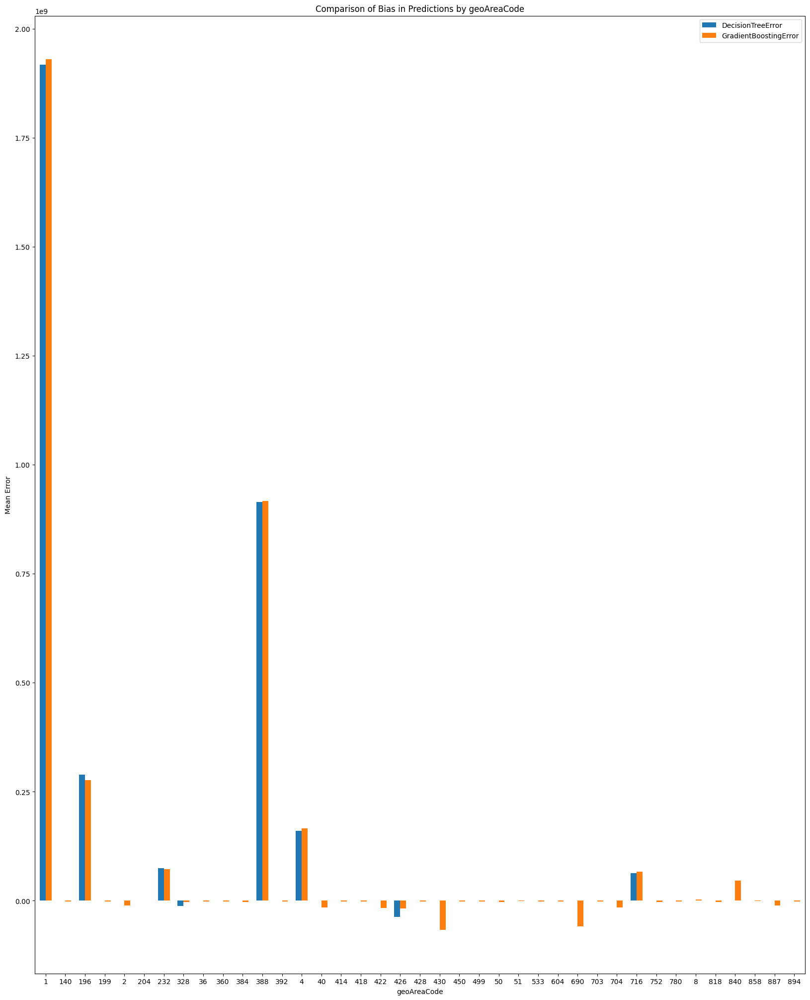

716    189
4      160
1       27
8       23
422     21
      ... 
703      1
196      1
248      1
124      1
442      1
Name: geoAreaCode, Length: 101, dtype: int64


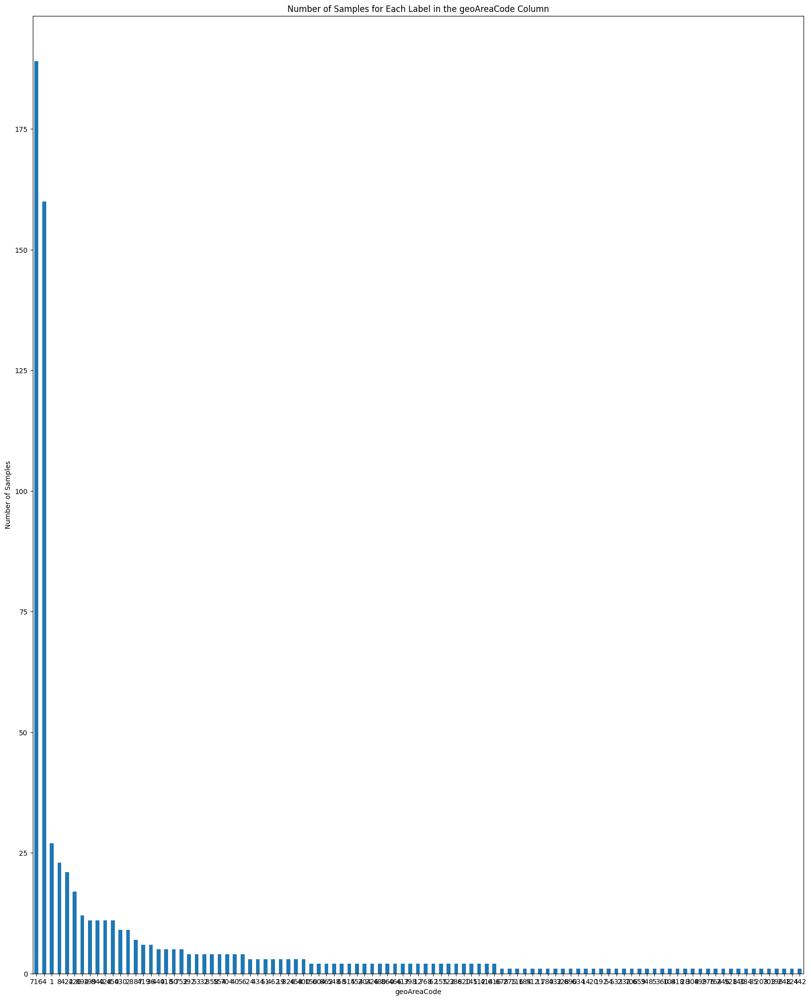

<Figure size 640x480 with 0 Axes>

In [23]:
def compute_bias_by_feature(model, X_test, y_test, feature_name):
    df_test = X_test.copy()
    df_test['True'] = y_test
    df_test['Predicted'] = model.predict(X_test)
    df_test['Error'] = df_test['True'] - df_test['Predicted']
    return df_test.groupby(feature_name)['Error'].mean()

# Compare errors for a particular feature (e.g., 'Sex')
geoAreaCode_bias_dt = compute_bias_by_feature(model_dt, X_test, y_test, 'geoAreaCode')
geoAreaCode_bias_gb = compute_bias_by_feature(model_gb, X_test, y_test, 'geoAreaCode')



bias_comparison_geoAreaCode = pd.DataFrame({
    'geoAreaCode': geoAreaCode_bias_dt.index,
    'DecisionTreeError': geoAreaCode_bias_dt.values,
    'GradientBoostingError': geoAreaCode_bias_gb.values
})

print(bias_comparison_geoAreaCode)


# Plotting the bias comparison for 'Sex'
bias_comparison_geoAreaCode.set_index('geoAreaCode').plot(kind='bar', figsize=(20, 25), width=0.6)
plt.title('Comparison of Bias in Predictions by geoAreaCode')
plt.ylabel('Mean Error')
plt.xlabel('geoAreaCode')
plt.xticks(rotation=0)
plt.savefig('geoAreaCode_1.png')
plt.show()

# Count the number of samples for each unique value in a specific feature (e.g., 'Sex')
label_counts = df['geoAreaCode'].value_counts()

print(label_counts)

# Plot the number of samples for each label
label_counts.plot(kind='bar', figsize=(20, 25))
plt.title('Number of Samples for Each Label in the geoAreaCode Column')
plt.xlabel('geoAreaCode')
plt.ylabel('Number of Samples')
plt.xticks(rotation=0)
plt.show()
plt.savefig('geoAreaCode.png')



    timePeriodStart  DecisionTreeError  GradientBoostingError
0              1992       8.157430e+00           7.205957e+04
1              1996       7.912430e+00           2.303583e+07
2              2000       3.597565e+04          -4.335193e+06
3              2001      -1.873492e+08          -8.813740e+07
4              2002       0.000000e+00          -2.037380e+06
5              2003      -4.677290e+01          -9.206312e+06
6              2004       0.000000e+00          -1.102419e+06
7              2005      -3.013123e+00          -2.693622e+06
8              2006       1.768472e+01          -1.311868e+06
9              2007       4.214775e+01          -1.311819e+06
10             2008      -2.470052e+01          -2.528116e+06
11             2009       2.797045e+01          -9.447843e+06
12             2010      -2.041061e+06          -3.318421e+06
13             2011      -1.873492e+08          -8.570489e+07
14             2013       1.417574e+01           5.127167e+04
15      

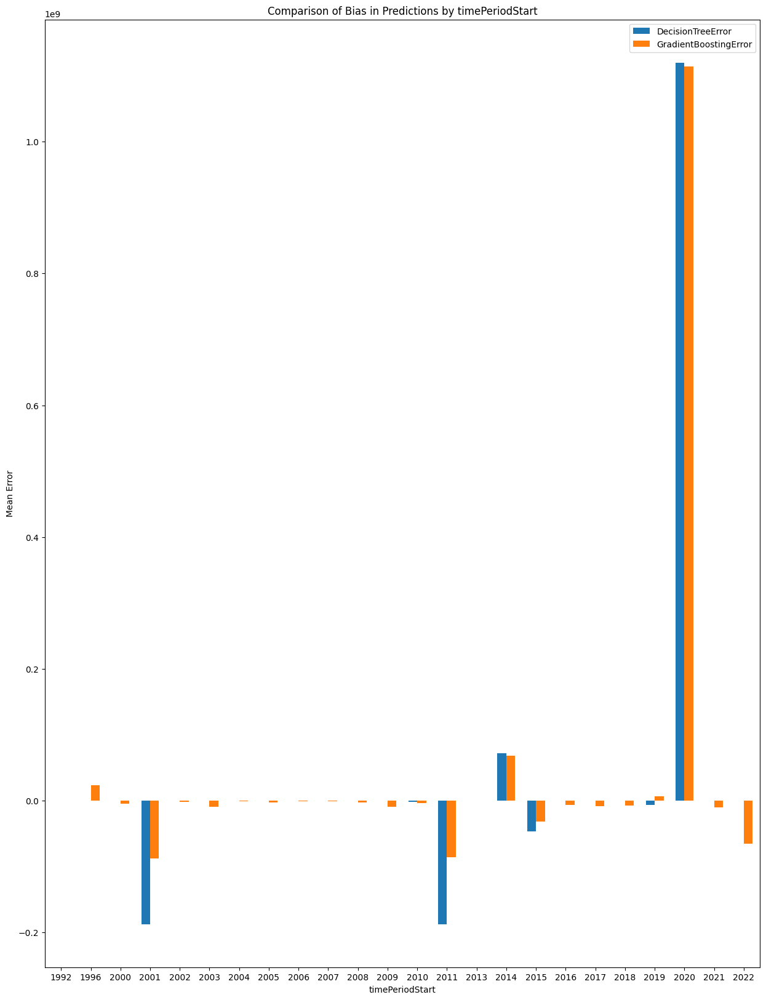

2020    110
2019     99
2000     65
2017     54
2018     46
2016     42
2021     37
2015     36
2009     18
2005     18
2010     17
2011     16
2014     16
2022     16
2007     14
2004     13
2012     13
2013     11
2006     10
2002     10
2008      9
2001      8
2003      6
1990      3
1992      2
1993      1
1996      1
1991      1
1994      1
1959      1
1995      1
1998      1
Name: timePeriodStart, dtype: int64


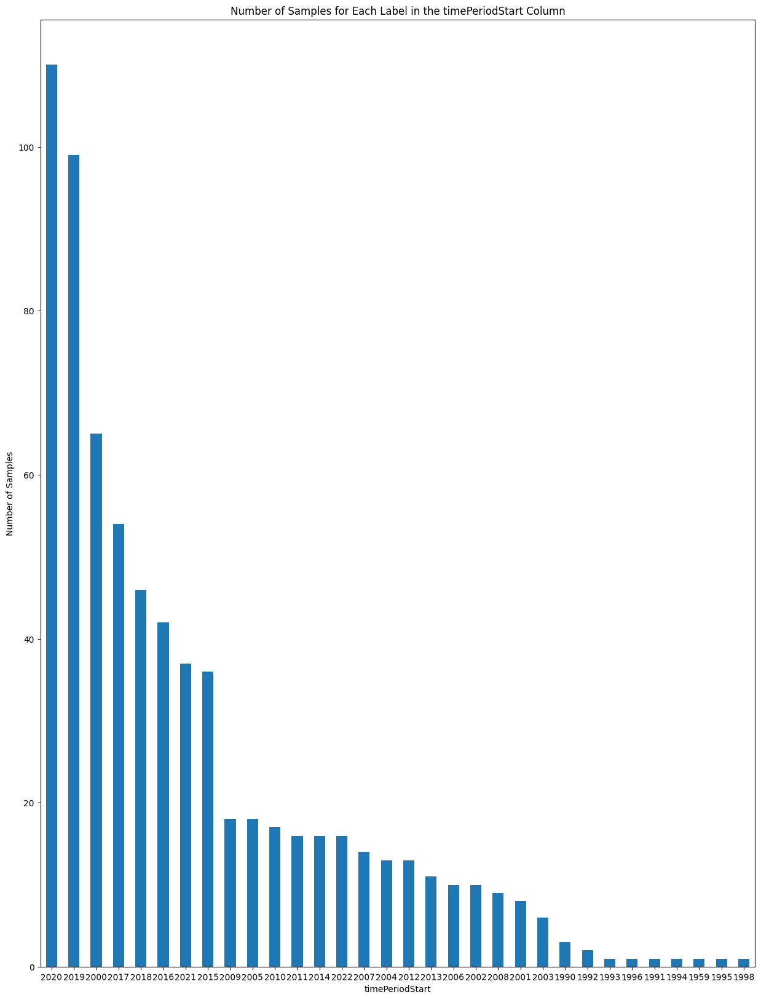

In [16]:
# Compare errors for a particular feature (e.g., 'Sex')
timePeriodStart_bias_dt = compute_bias_by_feature(model_dt, X_test, y_test, 'timePeriodStart')
timePeriodStart_bias_gb = compute_bias_by_feature(model_gb, X_test, y_test, 'timePeriodStart')


bias_comparison_timePeriodStart = pd.DataFrame({
    'timePeriodStart': timePeriodStart_bias_dt.index,
    'DecisionTreeError': timePeriodStart_bias_dt.values,
    'GradientBoostingError': timePeriodStart_bias_gb.values
})

print(bias_comparison_timePeriodStart)


# Plotting the bias comparison for 'Sex'
bias_comparison_timePeriodStart.set_index('timePeriodStart').plot(kind='bar', figsize=(15, 20), width=0.6)
plt.title('Comparison of Bias in Predictions by timePeriodStart')
plt.ylabel('Mean Error')
plt.xlabel('timePeriodStart')
plt.xticks(rotation=0)
plt.savefig('bias_comparison_timePeriodStart.png')
plt.show()



# Count the number of samples for each unique value in a specific feature (e.g., 'Sex')
label_counts = df_features['timePeriodStart'].value_counts()

print(label_counts)

# Plot the number of samples for each label
label_counts.plot(kind='bar', figsize=(15, 20))
plt.title('Number of Samples for Each Label in the timePeriodStart Column')
plt.xlabel('timePeriodStart')
plt.ylabel('Number of Samples')
plt.xticks(rotation=1)
plt.savefig('label_counts_timePeriodStart.png')
plt.show()

### Understanding the Biasness in models
Bias in models often arises when the training data is not evenly distributed across the classes or categories within a particular feature (or column). When certain categories (or labels) have more samples than others, the model tends to perform better on those categories because it has seen more examples during training. 

Here’s how the number of samples in a particular category affects model bias:

- More Samples in a Category:

The model sees more instances of timePeriodStart and geoAreaCode category, so it learns to predict this category more accurately. this results in develop a bias toward this category.

- Fewer Samples in a Category:

The model has fewer examples to learn from, so its predictions for this category are less accurate. So, the model might “ignore” or predict less frequently for this category because it lacks sufficient training data to understand it well.

## 2- Implementing Data Transparency Rules from Responsible AI

To implement data transparency, we need to focus on the following aspects:

- Clear Documentation: Providing clear documentation for each data field, its source, and its relevance.
- Data Provenance: Including data about the origin and source of the data, from where the data is gathered /get.
- Bias Identification: Identifying and documenting any biases present in the dataset.

#### Dataset Explaination:

Let's provide clear documentation for each field:

- goal: Represents the Sustainable Development Goal (SDG) that the data entry is related to.
- target: Specific targets under each goal.
- indicator: Indicators used to measure progress towards the targets.
- series: Unique identifier for the data series.
- seriesDescription: Detailed description of what the series measures.
- seriesCount: Number of entries in the series.
- geoAreaCode: Numeric code representing the geographical area.
- geoAreaName: Name of the geographical area.
- timePeriodStart: The start year of the time period the data covers.
- value: The measured value of the indicator.
- valueType: Type of the value (e.g., Float, Integer).
- time_detail: Additional details about the time period.
- timeCoverage: Description of the time coverage.
- upperBound: Upper bound of the measured value (if any).
- lowerBound: Lower bound of the measured value (if any).
- basePeriod: Reference period for the data.
- source: Origin or provider of the data.
- geoInfoUrl: URL with more information about the geographical data.
- footnotes: Additional notes or explanations about the data entry.
- attributes: Additional attributes related to the data, such as units and nature.
- dimensions: Breakdown of the data by specific dimensions like age, location, sex, and reporting type.
- key: Unique keys identifying the data entry.



#### Model Explaination:

We use two models to compare and check model biasness, Decision Tree and Gradient Booasting .A Decision Tree is a model that makes predictions by splitting data into branches based on certain conditions whereas Gradient Boosting is an ensemble technique that combines multiple weak learners (typically decision trees) to create a strong model.

We train both models on our dataset that consist of the following columns: goal, seriesCount, geoAreaCode, geoAreaName, timePeriodStart, Sex, Age, Reporting Type, Location, Nature, Units, and Observation.

Decision Tree model is more focused on timeStartPeriod, geoAreaCode whereas Gradient Booasting is more focused towards timeStartPeriod, geoAreaCode and geoAreaName_World. This shows that the model is biased towards certian features which shows the uneven data sample distribution in data. 
Model bias toward a particular column often stems from imbalances in the training data. If one category within a column has significantly more samples than others, the model becomes more confident and accurate in predicting that category, often at the expense of under-represented categories.



# Milestone 2 


## 3- Implementing Data Privacy Rule from Responsible AI
To implement the privacy rule from Responsible AI, we need to ensure that the data is protected. Here are some steps to protect data and ensure data protection.
### Steps to Implement Privacy Rule:
- Data Anonymization: Remove or anonymize personally identifiable information (PII) to ensure individuals cannot be identified.
- Encryption: Encrypt sensitive data to protect it from unauthorized access.

#### Data Anonymization:
Since the provided data is largely aggregated and does not contain obvious PII, we'll focus on ensuring that fields that might indirectly identify individuals are anonymized.

In [17]:
# data before anonymizing
df_features

,goal,seriesCount,geoAreaCode,geoAreaName,timePeriodStart,Sex,Age,Reporting Type,Location,Nature,Units,Observation
0,1,8748,32,Argentina,2020,BOTHSEX,ALLAGE,G,ALLAREA,,PERCENT,
1,1,32396,50,Bangladesh,2020,BOTHSEX,15+,G,,,PERCENT,
2,1,32396,716,Zimbabwe,2020,BOTHSEX,15+,G,,,PERCENT,
3,1,912,4,Afghanistan,2007,,,G,ALLAREA,,PERCENT,
4,1,912,450,Madagascar,2001,,,G,ALLAREA,,PERCENT,
...,...,...,...,...,...,...,...,...,...,...,...,...
691,9,3960,428,Latvia,2019,,,G,,,PERCENT,
692,9,3960,716,Zimbabwe,2019,,,G,,,PERCENT,
693,9,3699,4,Afghanistan,2007,,,G,,,PERCENT,
694,9,2278,40,Austria,2012,,,G,,,PERCENT,


In [18]:
# Anonymize data (if necessary)
# Here, we assume that 'geoAreaCode' and 'geoAreaName' might need anonymization. Anonymize data using Label Encoding
from sklearn.preprocessing import LabelEncoder

label_encoder_geo_area_code = LabelEncoder()
label_encoder_geo_area_name = LabelEncoder()

df_features['geoAreaCode'] = label_encoder_geo_area_code.fit_transform(df_features['geoAreaCode'])
df_features['geoAreaName'] = label_encoder_geo_area_name.fit_transform(df_features['geoAreaName'])

# data after anonymization
df_features

,goal,seriesCount,geoAreaCode,geoAreaName,timePeriodStart,Sex,Age,Reporting Type,Location,Nature,Units,Observation
0,1,8748,30,8,2020,BOTHSEX,ALLAGE,G,ALLAREA,,PERCENT,
1,1,32396,63,14,2020,BOTHSEX,15+,G,,,PERCENT,
2,1,32396,86,99,2020,BOTHSEX,15+,G,,,PERCENT,
3,1,912,40,0,2007,,,G,ALLAREA,,PERCENT,
4,1,912,55,57,2001,,,G,ALLAREA,,PERCENT,
...,...,...,...,...,...,...,...,...,...,...,...,...
691,9,3960,49,49,2019,,,G,,,PERCENT,
692,9,3960,86,99,2019,,,G,,,PERCENT,
693,9,3699,40,0,2007,,,G,,,PERCENT,
694,9,2278,41,13,2012,,,G,,,PERCENT,


Sensitive fields like <b> geoAreaCode</b> and <b>geoAreaName</b> are anonymized by encoding. The data is anonymized and protected, adhering to the privacy rule from Responsible AI.

## 4- Implementing Human Oversight Rule from Responsible AII

To implement the Human Oversight rule in your code, you can add mechanisms for logging, accountability, and transparency. This involves:

- Logging: Keep detailed logs of actions performed by the AI system, including decisions made by the model and any changes to the data or system.
- Documentation: Clearly document the roles and responsibilities of each stakeholder involved in the AI system's development, deployment, and monitoring.
- Review Process: Establish a review process where decisions made by the AI can be audited and verified by human stakeholders.
- Notifications and Alerts: Implement a notification system to alert responsible stakeholders about significant actions or decisions made by the AI system.

### Implementation Steps:

#### 1. Define Accountability
Create a documentation file where roles and responsibilities are clearly defined. This can be a simple text file or a more detailed document.


 ##### Accountability Document
---------------------------
1. Development Team: Responsible for creating and maintaining the AI model.
   - Lead Developer: Alice
   - Data Scientist: Bob
   - ML Engineer: Carol

2. Deployment Team: Responsible for deploying the AI model.
   - DevOps Engineer: Dave
   - Cloud Engineer: Eve

3. Monitoring Team: Responsible for monitoring the AI system's performance.
   - Data Analyst: Frank
   - System Administrator: Grace

4. Users: End users who interact with the AI system.
   - User Group A: Group A's responsibilities and rights
   - User Group B: Group B's responsibilities and rights

5. Stakeholders: Individuals who have a vested interest in the AI system's outcomes.
   - Project Manager: Hannah
   - Compliance Officer: Ian


#### 2. Document Decisions:
Add comments and logs in your code to document important decisions. Also, maintain a changelog for version control.

In [19]:

# Code snippets with documentation
import logging

# Set up logging
logging.basicConfig(filename='ai_system.log', level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

def load_data(file_path):
    logging.info(f"Loading data from {file_path}")
    # Data loading logic
    return data

def preprocess_data(data):
    logging.info("Starting data preprocessing")
    # Preprocessing logic
    return preprocessed_data

def train_model(X_train, y_train):
    logging.info("Training model")
    # Model training logic
    return model

# Document decisions within the code
logging.info("Selected Decision Tree Regressor for initial model due to interpretability.")
logging.info("Anonymized sensitive fields 'geoAreaCode' and 'geoAreaName'.")


##### 3. Logging and Monitoring
Implement logging within your code to trace the AI system's activities and performance.

In [20]:
# Example: Logging model performance
from sklearn.metrics import mean_squared_error

y_test.fillna(y_test.mean(), inplace=True)

def evaluate_model(model, X_test, y_test):
    predictions = model.predict(X_test)
    mse = mean_squared_error(y_test, predictions)
    logging.info(f"Model evaluation completed. Mean Squared Error: {mse}")
    return mse

# After model training and evaluation
mse = evaluate_model(model_dt, X_test, y_test)
logging.info(f"Final model's performance - MSE: {mse}")



#### 4. Review and Approval
Set up a review process where significant changes must be approved by stakeholders.

In [22]:
# Example: Review and approval process
review_board = {
    'Lead Developer': 'Alice',
    'Project Manager': 'Hannah',
    'Compliance Officer': 'Ian'
}

def request_approval(change_description):
    logging.info(f"Requesting approval for change: {change_description}")
    for role, person in review_board.items():
        logging.info(f"Approval needed from {role}: {person}")

# Requesting approval for a significant change
change_description = "Deployment of new model version 1.1.0 with added anonymization."
request_approval(change_description)


#### 5. User Training
Ensure users and stakeholders are properly trained.

##### User_Training_Guide 
-----------------------
1. Introduction to the AI System
2. How to Use the AI System
3. Understanding AI System Outputs
4. Reporting Issues and Feedback
5. Responsibilities and Rights of Users

By following these steps and implementing the code snippets, you ensure that the Human Oversight rule is applied effectively to your AI system, providing clear accountability, thorough documentation, logging and monitoring, a review and approval process, and user training. The log file is named <b> ai_system.log </b> and it is located in the same directory as your script.